## Notebook to plot 3D displacements over Jakarta and the metropolitan area

Authors: A.M.Lapadat and R.F.Hanssen Date: 12-2025

This notebook visualizes the 3D displacement velocity vectors over Jakarta esimated with the strap-down approach

No. representative (>2sigma) transversal vectors: (1949)
No. of skipped trasnversal vectors: (2830)


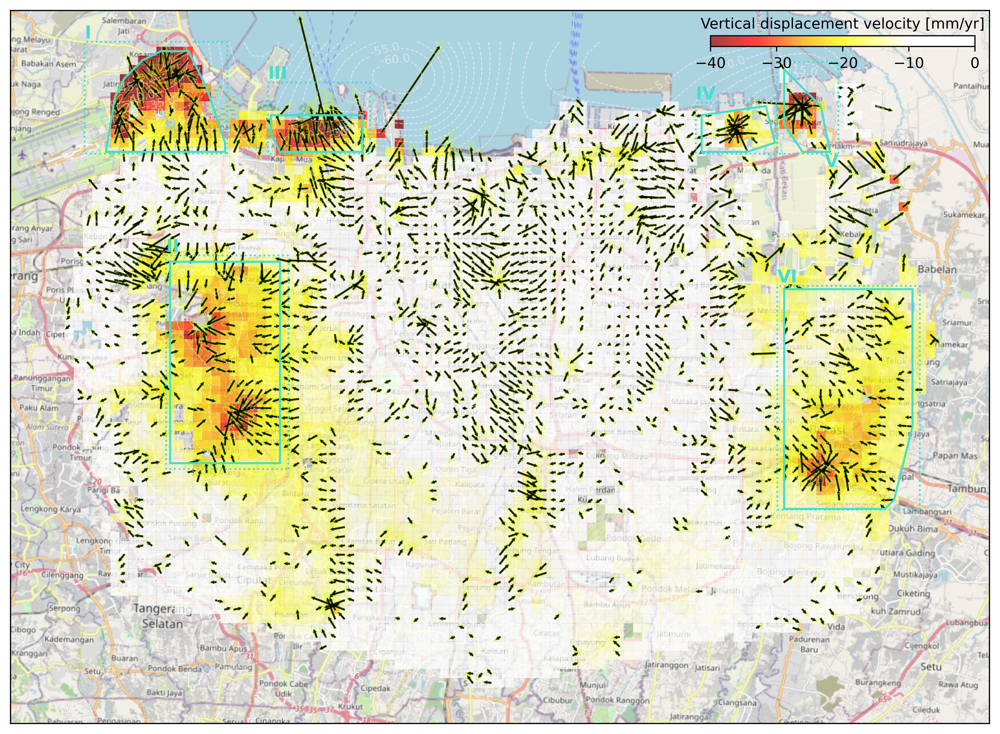

In [4]:
# --- Jakarta GNSS Displacement Plot (only significant 2σ vectors + subsidence outlines) ---
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse, Rectangle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import contextily as cx
from shapely.geometry import MultiPoint, box
from pykrige.ok import OrdinaryKriging
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.ticker as mticker

# --- Custom colormap ---
def create_hot_not_black_r_cmap():
    colors = [
        (0.0, "darkred"),
        (0.175, "red"),
        (0.35, "orange"),
        (0.50, "yellow"),
        (0.75, "white"),
        (1.0, "white")
    ]
    return LinearSegmentedColormap.from_list("hot_not_black_r", colors)

# --- Formatter for km labels ---
def meters_to_km_labels(x, pos):
    return f"{int(x // 1000)}"
formatter = mticker.FuncFormatter(meters_to_km_labels)

# --- Load Jakarta ENU data ---
data_path = 'jakarta_enu_estimates.pkl'
df = pd.read_pickle(data_path)

x_rum = df['x_rum'].values
y_rum = df['y_rum'].values
east_est = df['east'].values
north_est = df['north'].values
up_est = df['up'].values
var_east = df['var_east'].values
var_north = df['var_north'].values
covar_en = df['covar_en'].values

# --- Settings ---
scaling = 320  # mm/yr → plot units
n_std_plot = 2
plot_streetmap = True
nr_vectors_plot = len(x_rum)
random_idx = np.arange(nr_vectors_plot)

# --- Kriging for vertical displacement contour ---
grid_spacing = 500
xCoords = np.arange(np.min(x_rum), np.max(x_rum)+grid_spacing, grid_spacing)
yCoords = np.arange(np.min(y_rum), np.max(y_rum)+grid_spacing, grid_spacing)
X, Y = np.meshgrid(xCoords, yCoords)

OK_up = OrdinaryKriging(
    x_rum, y_rum, up_est,
    variogram_model='gaussian',
    variogram_parameters=[42, 7500, 6],
    verbose=False,
    enable_plotting=False
)
interp_contour_up, _ = OK_up.execute('grid', xCoords, yCoords)

# --- Figure setup ---
x_range = np.max(x_rum) - np.min(x_rum)
y_range = np.max(y_rum) - np.min(y_rum)
fig_width = 12
fig_height = fig_width / (x_range / y_range)
fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=500)

# --- Vertical displacement scatter ---
vmin, vmax = -40, 0
custom_cmap = create_hot_not_black_r_cmap()
sc = ax.scatter(
    x_rum, y_rum,
    c=up_est,
    s=37.7,
    alpha=0.75,
    cmap=custom_cmap,
    vmin=vmin, vmax=vmax,
    marker='s', linewidths=0
)

# --- Vector & ellipse scaling ---
transversal_mm_all = np.sqrt(east_est**2 + north_est**2) * scaling
head_len = 0.3 * np.mean(transversal_mm_all)
head_wid = head_len
wdt = 0.1 * np.mean(transversal_mm_all)

plotted_vectors = []
skipped_vectors = []

for k in range(nr_vectors_plot):
    x_coord_rum = x_rum[random_idx[k]]
    y_coord_rum = y_rum[random_idx[k]]
    east_rum = east_est[random_idx[k]] * scaling
    north_rum = north_est[random_idx[k]] * scaling

    Q_en = np.array([
        [var_east[random_idx[k]] * scaling**2, covar_en[random_idx[k]] * scaling**2],
        [covar_en[random_idx[k]] * scaling**2, var_north[random_idx[k]] * scaling**2]
    ])

    trans_displ_rum = np.sqrt(east_rum**2 + north_rum**2)

    # Skip non-significant vectors (2σ)
    eigenvals, _ = np.linalg.eigh(Q_en)
    width, height = n_std_plot * np.sqrt(eigenvals)
    if trans_displ_rum <= max(width/2, height/2):
        skipped_vectors.append(trans_displ_rum)
        continue

    plotted_vectors.append(trans_displ_rum)

    # --- Double-stroke arrow ---
    ax.arrow(
        x_coord_rum, y_coord_rum, east_rum, north_rum,
        length_includes_head=True, color='#CCFF00', alpha=0.8,
        width=wdt*2.1, head_length=head_len*1.3, head_width=head_wid*1.3, zorder=1
    )
    ax.arrow(
        x_coord_rum, y_coord_rum, east_rum, north_rum,
        length_includes_head=True, color='black', alpha=0.8,
        width=wdt, head_length=head_len, head_width=head_wid, zorder=2
    )

    # --- Ellipse at tip ---
    eigenvals, eigenvecs = np.linalg.eigh(Q_en)
    order = eigenvals.argsort()[::-1]
    eigenvals, eigenvecs = eigenvals[order], eigenvecs[:, order]
    angle = np.degrees(np.arctan2(*eigenvecs[:,0][::-1]))
    width, height = n_std_plot * np.sqrt(eigenvals)
    ellip = Ellipse(
        (x_coord_rum + east_rum, y_coord_rum + north_rum),
        width=width, height=height,
        angle=angle, ec='#CCFF00', fc='none', alpha=0.65, linewidth=0.55
    )
    ax.add_patch(ellip)

# --- Print vector statistics ---
print(f"No. representative (>2sigma) transversal vectors: ({len(plotted_vectors)})")
print(f"No. of skipped trasnversal vectors: ({len(skipped_vectors)})")

# --- Contours ---
contour_levels = np.arange(np.floor(np.min(interp_contour_up)/5)*5,
                           np.ceil(np.max(interp_contour_up)/5)*5 + 5, 5)
contour = ax.contour(
    X, Y, interp_contour_up,
    levels=contour_levels,
    colors='white', linestyles='dashed',
    alpha=0.5, linewidths=0.65
)
ax.clabel(contour, inline=True, fontsize=8, fmt="%.1f", colors='white')

# --- Subsurface bowls outlines ---
subsidence_regions = [
    (1557000, 807500, 1564000, 813000),
    (1561000, 792000, 1567000, 802500),
    (1566000, 807500, 1571000, 811000),
    (1587000, 807500, 1591000, 810000),
    (1591000, 807500, 1594000, 812000),
    (1591000, 790000, 1598000, 801000)
]
roman_labels = ["I", "II", "III", "IV", "V", "VI"]
turquoise = "#40E0D0"

for i, (x1, y1, x2, y2) in enumerate(subsidence_regions):
    xmin, xmax = min(x1, x2), max(x1, x2)
    ymin, ymax = min(y1, y2), max(y1, y2)
    inside = (x_rum >= xmin) & (x_rum <= xmax) & (y_rum >= ymin) & (y_rum <= ymax)
    idx = np.nonzero(inside)[0]

    if idx.size >= 3:
        pts = [(x_rum[j], y_rum[j]) for j in idx]
        hull = MultiPoint(pts).convex_hull
        hx, hy = hull.exterior.xy
        ax.plot(hx, hy, linestyle='-', linewidth=1.4, color=turquoise, zorder=10)

    rect = box(xmin, ymin, xmax, ymax)
    rx, ry = rect.exterior.xy
    ax.plot(rx, ry, linestyle=':', linewidth=1.2, color=turquoise, zorder=9)

    if i == 4:
        ax.text(xmax, ymin, roman_labels[i], color=turquoise, fontsize=12,
                fontweight='bold', ha='right', va='top', zorder=12)
    else:
        ax.text(xmin, ymax, roman_labels[i], color=turquoise, fontsize=12,
                fontweight='bold', ha='left', va='bottom', zorder=12)

# --- Axis limits and basemap ---
ax.set_xlim(np.min(x_rum)-2000, np.max(x_rum)+2000)
ax.set_ylim(np.min(y_rum)-2000, np.max(y_rum)+2000)
ax.set_aspect('equal', adjustable='datalim')
ax.set_xticks([])
ax.set_yticks([])
if plot_streetmap:
    cx.add_basemap(ax, crs='epsg:23830', source=cx.providers.OpenStreetMap.Mapnik, zoom=12, attribution=False)

# --- Colorbar ---
cax = inset_axes(ax, width="27%", height="1.5%", loc='upper right',
                 bbox_to_anchor=(0, -0.015, 1, 1), bbox_transform=ax.transAxes, borderpad=1)
cbar = plt.colorbar(sc, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.set_label('Vertical displacement velocity [mm/yr]', labelpad=5)

plt.show()


In [5]:
## Compute basic mean and std statistics over entire velocity field and exluding the 6 subsidence bowl regions
# --- Compute transversal displacement ---
trans_displ_rum = np.sqrt(east_est**2 + north_est**2)

# --- Define subsidence regions as polygons for masking ---
from shapely.geometry import Polygon, Point

subsidence_polygons = []
for x1, y1, x2, y2 in subsidence_regions:
    poly = Polygon([
        (x1, y1),
        (x1, y2),
        (x2, y2),
        (x2, y1)
    ])
    subsidence_polygons.append(poly)

# --- Mask points outside all subsidence regions ---
outside_mask = np.ones(len(x_rum), dtype=bool)
for poly in subsidence_polygons:
    for i in range(len(x_rum)):
        if poly.contains(Point(x_rum[i], y_rum[i])):
            outside_mask[i] = False

# --- Compute statistics function ---
def print_stats(label, values, mask=None):
    if mask is not None:
        values = values[mask]
    mean_val = np.mean(values)
    std_val = np.std(values)
    print(f"{label}: mean = {mean_val:.2f}, std = {std_val:.2f}")

# --- Print statistics ---
print("\n--- Velocity statistics (all points) ---")
print_stats("East [mm/yr]", east_est)
print_stats("North [mm/yr]", north_est)
print_stats("Up [mm/yr]", up_est)
print_stats("Transversal [mm/yr]", trans_displ_rum)

print("\n--- Velocity statistics (outside 6 subsidence regions) ---")
print_stats("East [mm/yr]", east_est, mask=outside_mask)
print_stats("North [mm/yr]", north_est, mask=outside_mask)
print_stats("Up [mm/yr]", up_est, mask=outside_mask)
print_stats("Transversal [mm/yr]", trans_displ_rum, mask=outside_mask)



--- Velocity statistics (all points) ---
East [mm/yr]: mean = -0.02, std = 0.73
North [mm/yr]: mean = 0.03, std = 0.78
Up [mm/yr]: mean = -11.22, std = 7.26
Transversal [mm/yr]: mean = 0.73, std = 0.78

--- Velocity statistics (outside 6 subsidence regions) ---
East [mm/yr]: mean = 0.01, std = 0.66
North [mm/yr]: mean = -0.00, std = 0.62
Up [mm/yr]: mean = -9.06, std = 4.53
Transversal [mm/yr]: mean = 0.64, std = 0.65
